In [9]:
import scipy.io
import scipy as sc
import numpy as np
from ssmlearnpy import SSMLearn
import matplotlib.pyplot as plt
from factor_analyzer import FactorAnalyzer

# data = np.load("Re8000/run1/UP_field_alldata.npy").squeeze()
# Create training dataset by iterating over all runs
trajectories = []
times = []
time = np.linspace(0, int(100*0.005), 100//20)
Re = 8000

start_idx = 0
run_data = np.load(f"Re{Re}/run1/UP_field_alldata.npy").squeeze()
# steady_state = np.mean(run_data[:,100:], axis=1)
steady_state = np.load(f"Re{Re}/run1/UP0_field_data.npy").squeeze()
V_coords = np.load(f"Re{Re}/run1/V_dof_coordinates.npy")
for run_idx in range(1, 9):  # Assuming runs 1-5, adjust as needed
    try:
        run_data = np.load(f"Re{Re}/run{run_idx}/UP_field_alldata.npy").squeeze()
        trajectories.append((run_data-steady_state.reshape(-1,1))[:,start_idx:])
        times.append(time[start_idx:])  # Same time array for each run
        print(f"Loaded run {run_idx} with shape: {trajectories[run_idx-1].shape}")
    except FileNotFoundError:
        print(f"Run {run_idx} not found, skipping...")
        continue

print(f"Total trajectories loaded: {len(trajectories)}")

Loaded run 1 with shape: (70339, 7)
Loaded run 2 with shape: (70339, 7)
Loaded run 3 with shape: (70339, 7)
Loaded run 4 with shape: (70339, 7)
Loaded run 5 with shape: (70339, 7)
Loaded run 6 with shape: (70339, 7)
Loaded run 7 with shape: (70339, 7)
Loaded run 8 with shape: (70339, 7)
Total trajectories loaded: 8


In [10]:
# slow_eigenvector = scipy.io.loadmat(f"Re{Re}/slow_eigenvector.mat")["found_vec"]

In [11]:
# In your analysis scripts:
V_to_W_mapping = np.load(f"Re{Re}/run1/V_to_W_vel_mapping.npy")
mixed_data = np.load(f"Re{Re}/run1/UP_field_alldata.npy")

# Extract velocity from any snapshot
velocity_data = mixed_data[V_to_W_mapping, :, :]  # All snapshots, all files
velocity_snapshot = mixed_data[V_to_W_mapping, 0, 0]  # Single snapshot

In [12]:
velocity_data = trajectories[0][V_to_W_mapping,:]

Grid resolution: 200x200
Domain: x=[0.000, 1.000], y=[0.000, 1.000]
Snapshot: 0


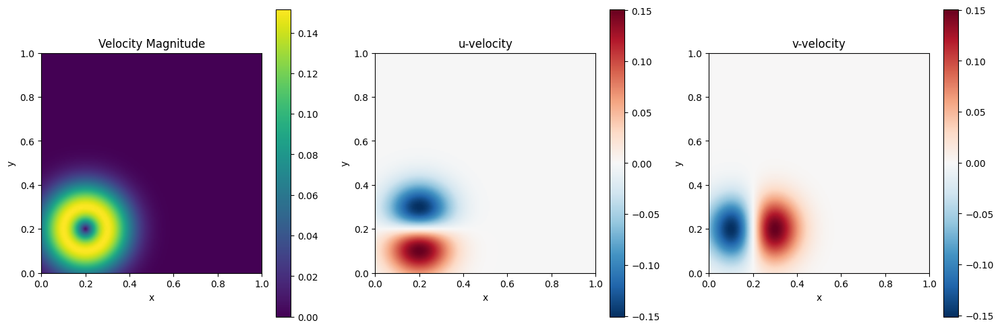

In [16]:
# In your notebook
from pathlib import Path
from plot_utils import plot_velocity_fields, plot_velocity_magnitude_only

# Load data
# data_dir = Path("Re6000/run1")
# U_data = np.load(data_dir / "U_field_alldata.npy")
# U_data = np.load(f"Re{Re}/run1/U_field_alldata.npy")
# U_data = np.load(f"Re{Re}/run1/U0_field_data.npy")
# U_data = trajectories[0]
# V_coords = np.load(data_dir / "V_dof_coordinates.npy")

# Plot all three velocity fields
fig, axes = plot_velocity_fields(velocity_data, V_coords, snapshot_idx=0)
plt.show()

# # Or plot just velocity magnitude
# fig, ax = plot_velocity_magnitude_only(U_data, V_coords, snapshot_idx=0)
# plt.show()

In [ ]:
from ssmlearnpy.utils.preprocessing import get_matrix
data_matrix = get_matrix(trajectories)
# POD modes:
U, s, v = np.linalg.svd(data_matrix, full_matrices = False)

In [ ]:
dim_reduction = 2
red_basis = U[:, :dim_reduction]

NameError: name 'U' is not defined

In [453]:
# from factor_analyzer import Rotator
# num_factors = 3
# projected_data = U[:, :num_factors].T @ data_matrix

# rotator = Rotator(method='promax')
# rotated_projections = rotator.fit_transform(projected_data.T)

# rotation_matrix = rotator.rotation_
# red_basis = (U[:, :num_factors]@ rotation_matrix)[:,:dim_reduction]

In [454]:
# # DMD Modes:
# V1 = data_matrix[:,:-1]
# V2 = data_matrix[:,1:]
# U, s, v = np.linalg.svd(V1, full_matrices = False)
# A_tilde = U.T @ V2 @ v.T @ np.diag(1/s)
# eigenvecs = np.linalg.eig(A_tilde)[1]
# dmd_modes = (U@eigenvecs)[:,:dim_reduction//2]
# red_basis = np.hstack([np.real(dmd_modes), np.imag(dmd_modes)])


In [455]:
red_basis

array([[ 9.51754827e-04,  1.55894324e-04],
       [ 1.09758056e-03,  6.62349731e-04],
       [-3.57867271e-16,  5.07739323e-16],
       ...,
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00]])

In [456]:
def encode(x):
    return np.dot(red_basis.T, x)#/np.sqrt(s[:dim_reduction]).reshape(-1, 1)

In [457]:
trajectories = []
times = []
time = np.linspace(0, int(30000*0.005), 30000//20)
# start_indices = [0, 0, 0, 0, 0, 0, 0, 0]
start_indices = [300, 300, 0, 300, 250, 200, 550, 200]
for run_idx in range(1, 9):
    try:
        start_idx = start_indices[run_idx-1]
        run_data = np.load(f"Re{Re}/run{run_idx}/U_field_alldata.npy").squeeze()
        trajectories.append((run_data-steady_state.reshape(-1,1))[:,start_idx:])
        times.append(time[start_idx:])  # Same time array for each run
        print(f"Loaded run {run_idx} with shape: {trajectories[run_idx-1].shape}")
    except FileNotFoundError:
        print(f"Run {run_idx} not found, skipping...")
        continue

print(f"Total trajectories loaded: {len(trajectories)}")

Loaded run 1 with shape: (33170, 1200)
Loaded run 2 with shape: (33170, 1200)
Loaded run 3 with shape: (33170, 1500)
Loaded run 4 with shape: (33170, 1200)
Loaded run 5 with shape: (33170, 1250)
Loaded run 6 with shape: (33170, 1300)
Loaded run 7 with shape: (33170, 950)
Loaded run 8 with shape: (33170, 1300)
Total trajectories loaded: 8


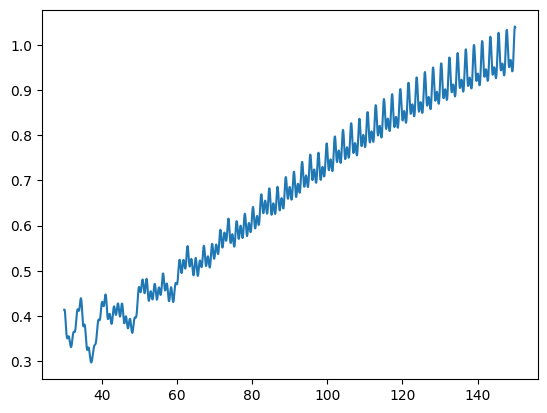

In [458]:
plt.plot(times[0], np.linalg.norm(trajectories[0], axis=0), label="Norms")


In [459]:
red_coords = []

for traj in trajectories:
    red_coords.append(encode(traj))

In [460]:
ssm = SSMLearn(
    t = times,
    x = trajectories,
    reduced_coordinates=red_coords,
    ssm_dim=dim_reduction, 
    dynamics_type = 'flow',
    # dynamics_structure="normalform"
)

ssm.get_parametrization(poly_degree=1, fit_intercept=False)    
ssm.get_parametrization(poly_degree=2, fit_intercept=False) 
# ssm.get_reduced_dynamics(poly_degree=3)

INFO   2025-07-08 15:16:39 ridge Transforming data
INFO   2025-07-08 15:16:40 ridge Skipping CV on ridge regression
INFO   2025-07-08 15:16:40 ridge Using polynomial features degree 1
INFO   2025-07-08 15:16:40 ridge Fitting regression model
INFO   2025-07-08 15:16:43 ridge Transforming data
INFO   2025-07-08 15:16:44 ridge Skipping CV on ridge regression
INFO   2025-07-08 15:16:44 ridge Using polynomial features degree 2
INFO   2025-07-08 15:16:44 ridge Fitting regression model


In [461]:
from ssmlearnpy.utils.plots import Plot
## to force the plots to render
# might need to uncomment jupyterlab
import plotly.io as pio
pio.renderers.default='notebook'
# pio.renderers.default='jupyterlab'

plotter = Plot(
    label_observables = 'obs',
)

In [462]:
fig = plotter.make_plot(
    ssm, 
    data_name = 'observables', 
    idx_trajectories=[0], 
    idx_coordinates=[10000, 2000, 6000], 
    add_surface = True, 
)
fig.show()

In [463]:
from ssmlearnpy.reduced_dynamics.shift_or_differentiate import shift_or_differentiate
from ssmlearnpy.utils.ridge import get_fit_ridge
# X is list of len num_trajs, X[0] has shape (2,timesteps), same for y

X, y = shift_or_differentiate(
            ssm.emb_data['reduced_coordinates'], 
            ssm.emb_data['time'], 
            ssm.dynamics_type,
            accuracy=8,
            method="findiff"
)

In [464]:
ssm.reduced_dynamics = get_fit_ridge(
        X,
        y,
        poly_degree=3, do_scaling = True,
)
linear_part = ssm.reduced_dynamics.map_info['coefficients'][:,:X[0].shape[0]]
d, v = np.linalg.eig(linear_part)
ssm.reduced_dynamics.map_info['eigenvalues_linear_part'] = d
ssm.reduced_dynamics.map_info['eigenvectors_linear_part'] = v

INFO   2025-07-08 15:16:48 ridge Transforming data
INFO   2025-07-08 15:16:48 ridge Skipping CV on ridge regression
INFO   2025-07-08 15:16:48 ridge Using polynomial features degree 3
INFO   2025-07-08 15:16:48 ridge Fitting regression model


In [465]:
# import ssmlearnpy.reduced_dynamics.normalform as normalform
# from scipy.optimize import minimize, least_squares
# from sklearn.preprocessing import PolynomialFeatures

# ndofs = int(linear_part.shape[0] / 2)
# if ssm.ssm_dim % 2 != 0:
#     raise NotImplementedError(
#         (
#             f"Normal form transformation not implemented for odd dimensions."
#         )
#     )
# normalform_args = {'degree': 3, 'do_scaling' : True,
#                             'tolerance': None, 'ic_style': 'random', 
#                             'max_iter': 1000, 'method': 'lm',
#                               'jac': '2-point'}
# nf_object, n_unknowns_dynamics, n_unknowns_transformation, objective = normalform.create_normalform_transform_objective(
#     ssm.emb_data['time'],
#       ssm.emb_data['reduced_coordinates'],
#       linear_part, degree = normalform_args['degree'],
#       do_scaling = normalform_args['do_scaling'],
#       tolerance = normalform_args['tolerance'],
#       use_center_manifold_style = True)

# initial_guess = normalform.create_normalform_initial_guess(ssm.reduced_dynamics, nf_object)

# res = least_squares(objective, 
#                     initial_guess,
#                       method=normalform_args['method'],
#                         jac=normalform_args['jac'], 
#                         max_nfev=normalform_args['max_iter'])
# unpacked_coeffs = normalform.unpack_optimized_coeffs(res.x, ndofs, nf_object, n_unknowns_dynamics, n_unknowns_transformation)
# transformation, dynamics = normalform.wrap_optimized_coefficients(ndofs,
#                                                                                  nf_object, normalform_args['degree'],
#                                                                                    unpacked_coeffs, find_inverse = True,
#                                                                                     trajectories = ssm.emb_data['reduced_coordinates'])
# ssm.normalform_transformation = transformation
# ssm.reduced_dynamics = dynamics
# ssm.reduced_dynamics.map_info['normalform_transformation'] = transformation
# T = ssm.normalform_transformation.transform
# T_inv = ssm.normalform_transformation.inverse_transform
# T_linear = ssm.normalform_transformation.linear_transform


In [466]:
ssm.reduced_dynamics.map_info['coefficients']


array([[-0.03593003,  3.08481347,  0.01053649, -0.05069183,  0.07185175,
         0.03817994, -0.02631032,  0.00655441, -0.06406695],
       [-2.71076108,  0.06953692,  0.27313886, -0.03834304,  0.14532974,
        -0.07060432, -0.05142833, -0.05738602, -0.06525133]])

In [487]:
test_index = 1
# v_init = trajectories[test_index][:,0]
etas = encode(trajectories[test_index])
eta_init = etas[:,0]
def rhs(t, x):
    x = x.reshape(1,-1)
    return (ssm.reduced_dynamics.predict(x)).reshape(-1,1).squeeze()
t0 = times[test_index][0]
t_final = times[test_index][-1]

In [488]:
# test_index = 0
# etas = encode(trajectories[test_index])
# eta_init = etas[:,0]
# z = T_inv(etas)
# z_init = z[:, 0]

# def rhs(t, z):
#     z = z.reshape(-1,1)
#     autonomous_dynamics = ssm.reduced_dynamics.map_info['vectorfield'](t=t, x=z)[0]
#     return np.array([autonomous_dynamics, np.conj(autonomous_dynamics)])

In [489]:
sol = sc.integrate.solve_ivp(rhs, (t0, t_final), eta_init, t_eval=times[test_index], method="DOP853")

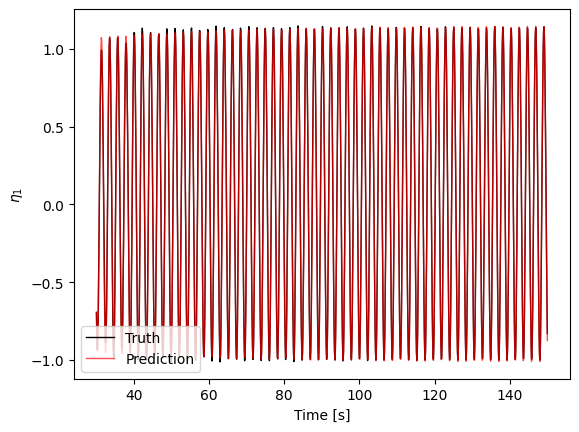

In [490]:
plt.figure()
plt.plot(times[test_index], etas[0,:], color="black", linewidth=1.0, label="Truth")
plt.plot(sol.t, sol.y[0,:], color="red", linewidth=1.0, label="Prediction", alpha=0.7)
plt.legend(loc="lower left")
plt.ylabel("$\eta_1$")
plt.xlabel("Time [s]")
plt.show()

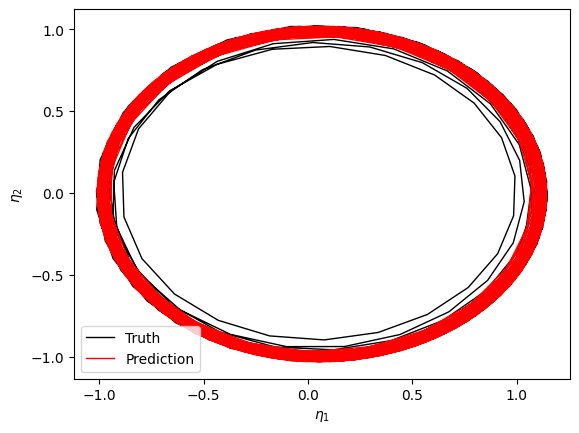

In [491]:
plt.figure()
start_idx = 0
plt.plot(etas[0,start_idx:], etas[1,start_idx:], color="black", linewidth=1, label="Truth")
plt.plot(sol.y[0,start_idx:], sol.y[1,start_idx:], color="red", linewidth=1, label="Prediction")
plt.legend(loc="lower left")
plt.xlabel("$\eta_1$")
plt.ylabel("$\eta_2$")
plt.show()

In [492]:
u_delta_a = np.mean(trajectories[test_index], axis=1)
u_delta_b = u_delta_a - np.dot(encode(u_delta_a), red_basis.T)
shift_mode = u_delta_b / np.linalg.norm(u_delta_b)
def calculate_shift_coefficient(trajectory, shift_mode):
    return np.dot(shift_mode.T, trajectory)

In [493]:
import plotly.graph_objects as go

# Create grid for SSM surface
xx = np.linspace(-1.2, 1.2, 100)
yy = np.linspace(-1.2, 1.2, 100)
X, Y = np.meshgrid(xx, yy)
points = np.vstack((X.ravel(), Y.ravel()))

# Decode points using SSM and calculate shift coefficients
Z_decoded = ssm.decode(points)  # shape: (N, d)
shift_coeff_surface = np.dot(shift_mode.T, Z_decoded).reshape(X.shape)  # Project onto shift mode

# Trajectory shift coefficients
shift_coeff_trajectory = calculate_shift_coefficient(trajectories[test_index], shift_mode)

# Predicted trajectory shift coefficients using SSM decode
ssm_prediction = ssm.decode(sol.y)  # sol.y.T has shape (n_timesteps, 2)
shift_coeff_predicted = calculate_shift_coefficient(ssm_prediction, shift_mode)

# Plotly 3D surface
surface = go.Surface(
    x=X, y=Y, z=shift_coeff_surface,
    colorscale='Blues',
    opacity=0.7,
    showscale=False,
)

# True trajectory as 3D line
trajectory = go.Scatter3d(
    x=etas[0, :],
    y=etas[1, :],
    z=shift_coeff_trajectory,
    mode='lines',
    line=dict(color='black', width=4),
    name='True Trajectory',
)

# Predicted trajectory as 3D line
trajectory_predicted = go.Scatter3d(
    x=sol.y[0, :],
    y=sol.y[1, :],
    z=shift_coeff_predicted,
    mode='lines',
    line=dict(color='red', width=4),
    name='SSM Predicted Trajectory',
)

# Combine and layout
fig = go.Figure(data=[surface, trajectory, trajectory_predicted])
fig.update_layout(
    scene=dict(
        xaxis_title=r'$\eta_1$',
        yaxis_title=r'$\eta_2$',
        zaxis_title='Shift Mode Coefficient',
    ),
    title='SSM Manifold with Shift Mode Coefficient',
    width=800,
    height=800,
)

fig.show()

Dominant frequency in eta1: 0.4568 Hz
Dominant frequency in eta2: 0.4568 Hz
Period eta1: 2.1890 s
Period eta2: 2.1890 s


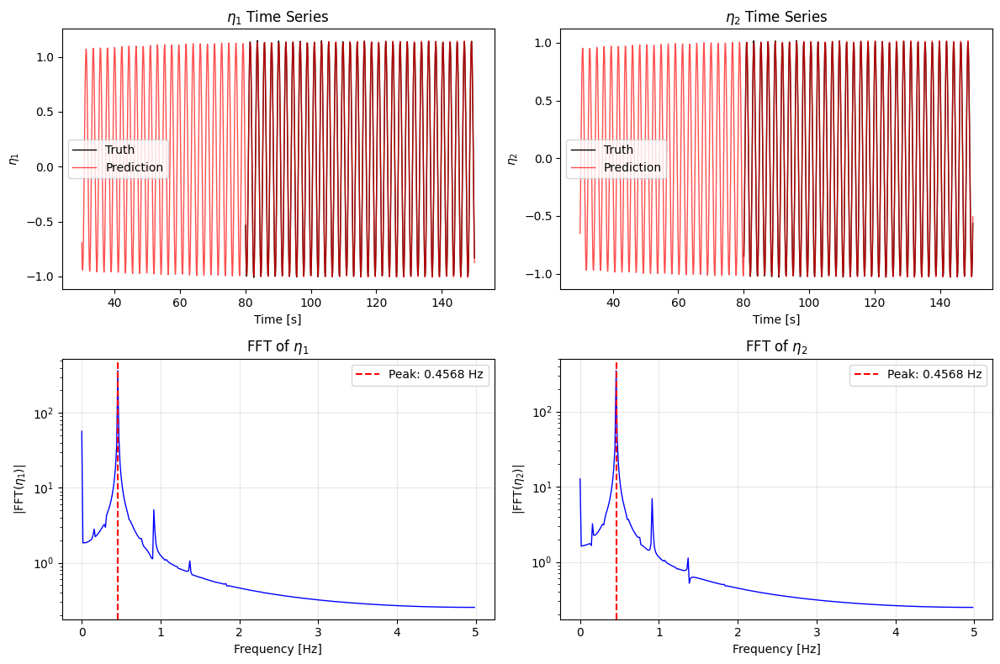


Dominant frequency in |eta|: 0.4568 Hz
Period |eta|: 2.1890 s


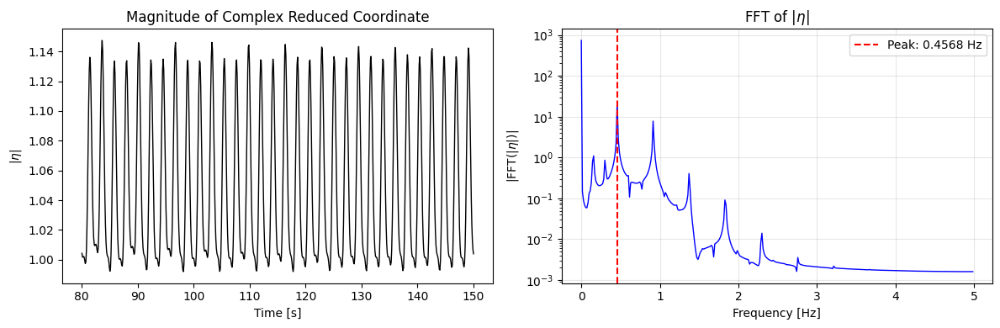

In [494]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

# Get the time series data
t = times[test_index][500:]
eta1_signal = etas[0, 500:]
eta2_signal = etas[1, 500:]

# Calculate sampling parameters
dt = t[1] - t[0]  # Time step
fs = 1 / dt       # Sampling frequency
N = len(eta1_signal)  # Number of samples

# Perform FFT on eta1
fft_eta1 = fft(eta1_signal)
fft_eta2 = fft(eta2_signal)

# Get frequency array
freqs = fftfreq(N, dt)

# Only take positive frequencies
positive_freqs = freqs[:N//2]
fft_eta1_positive = np.abs(fft_eta1[:N//2])
fft_eta2_positive = np.abs(fft_eta2[:N//2])

# Find dominant frequency (excluding DC component at freq=0)
# Start from index 1 to skip DC component
dominant_freq_idx_eta1 = np.argmax(fft_eta1_positive[1:]) + 1
dominant_freq_idx_eta2 = np.argmax(fft_eta2_positive[1:]) + 1

dominant_freq_eta1 = positive_freqs[dominant_freq_idx_eta1]
dominant_freq_eta2 = positive_freqs[dominant_freq_idx_eta2]

print(f"Dominant frequency in eta1: {dominant_freq_eta1:.4f} Hz")
print(f"Dominant frequency in eta2: {dominant_freq_eta2:.4f} Hz")
print(f"Period eta1: {1/dominant_freq_eta1:.4f} s")
print(f"Period eta2: {1/dominant_freq_eta2:.4f} s")

# Create plots
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Time series plots
axes[0, 0].plot(t, eta1_signal, 'k-', linewidth=1, label='Truth')
axes[0, 0].plot(sol.t, sol.y[0, :], 'r-', linewidth=1, alpha=0.7, label='Prediction')
axes[0, 0].set_xlabel('Time [s]')
axes[0, 0].set_ylabel('$\\eta_1$')
axes[0, 0].legend()
axes[0, 0].set_title('$\\eta_1$ Time Series')

axes[0, 1].plot(t, eta2_signal, 'k-', linewidth=1, label='Truth')
axes[0, 1].plot(sol.t, sol.y[1, :], 'r-', linewidth=1, alpha=0.7, label='Prediction')
axes[0, 1].set_xlabel('Time [s]')
axes[0, 1].set_ylabel('$\\eta_2$')
axes[0, 1].legend()
axes[0, 1].set_title('$\\eta_2$ Time Series')

# FFT plots
axes[1, 0].semilogy(positive_freqs, fft_eta1_positive, 'b-', linewidth=1)
axes[1, 0].axvline(dominant_freq_eta1, color='r', linestyle='--', 
                   label=f'Peak: {dominant_freq_eta1:.4f} Hz')
axes[1, 0].set_xlabel('Frequency [Hz]')
axes[1, 0].set_ylabel('|FFT($\\eta_1$)|')
axes[1, 0].set_title('FFT of $\\eta_1$')
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

axes[1, 1].semilogy(positive_freqs, fft_eta2_positive, 'b-', linewidth=1)
axes[1, 1].axvline(dominant_freq_eta2, color='r', linestyle='--', 
                   label=f'Peak: {dominant_freq_eta2:.4f} Hz')
axes[1, 1].set_xlabel('Frequency [Hz]')
axes[1, 1].set_ylabel('|FFT($\\eta_2$)|')
axes[1, 1].set_title('FFT of $\\eta_2$')
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Also compute FFT of the magnitude of the complex signal
eta_complex = eta1_signal + 1j * eta2_signal
eta_magnitude = np.abs(eta_complex)

fft_magnitude = fft(eta_magnitude)
fft_magnitude_positive = np.abs(fft_magnitude[:N//2])
dominant_freq_idx_mag = np.argmax(fft_magnitude_positive[1:]) + 1
dominant_freq_magnitude = positive_freqs[dominant_freq_idx_mag]

print(f"\nDominant frequency in |eta|: {dominant_freq_magnitude:.4f} Hz")
print(f"Period |eta|: {1/dominant_freq_magnitude:.4f} s")

# Plot magnitude and its FFT
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

axes[0].plot(t, eta_magnitude, 'k-', linewidth=1)
axes[0].set_xlabel('Time [s]')
axes[0].set_ylabel('$|\\eta|$')
axes[0].set_title('Magnitude of Complex Reduced Coordinate')

axes[1].semilogy(positive_freqs, fft_magnitude_positive, 'b-', linewidth=1)
axes[1].axvline(dominant_freq_magnitude, color='r', linestyle='--', 
               label=f'Peak: {dominant_freq_magnitude:.4f} Hz')
axes[1].set_xlabel('Frequency [Hz]')
axes[1].set_ylabel('|FFT($|\\eta|$)|')
axes[1].set_title('FFT of $|\\eta|$')
axes[1].legend()
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [496]:
print(2*np.pi*dominant_freq_eta1)
print(2*np.pi*dominant_freq_eta2)
(2*np.pi*dominant_freq_eta1-2.85)/2.85

2.870398407760062
2.870398407760062


0.0071573360561620536

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import griddata

def extract_centerline_velocities(U_data, V_coords, cavity_bounds=None, n_points=101):
    """
    Extract centerline velocities for lid-driven cavity comparison with Ghia et al.
    Uses interpolation for unstructured meshes.
    
    Parameters:
    -----------
    U_data : np.ndarray
        Velocity data array (steady state)
    V_coords : np.ndarray
        Velocity DOF coordinates, shape (n_dofs, 2)
    cavity_bounds : dict, optional
        Dictionary with keys 'x_min', 'x_max', 'y_min', 'y_max'
    n_points : int
        Number of points along each centerline (default: 101)
    
    Returns:
    --------
    dict with centerline data
    """
    
    # Handle data shape
    if U_data.ndim == 3:
        U_snapshot = U_data[:, 0, 0]  # Take first snapshot
    elif U_data.ndim == 2:
        U_snapshot = U_data[:, 0]
    else:
        U_snapshot = U_data
    
    # Extract u and v values (interleaved DOF format)
    u_vals = U_snapshot[0::2]  # u-velocities
    v_vals = U_snapshot[1::2]  # v-velocities
    coords = V_coords[0::2, :]  # coordinates
    
    # Determine cavity bounds
    if cavity_bounds is None:
        x_min, x_max = coords[:, 0].min(), coords[:, 0].max()
        y_min, y_max = coords[:, 1].min(), coords[:, 1].max()
    else:
        x_min, x_max = cavity_bounds['x_min'], cavity_bounds['x_max']
        y_min, y_max = cavity_bounds['y_min'], cavity_bounds['y_max']
    
    # Calculate centerlines
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    
    print(f"Cavity bounds: x=[{x_min:.3f}, {x_max:.3f}], y=[{y_min:.3f}, {y_max:.3f}]")
    print(f"Centerlines: x_center={x_center:.3f}, y_center={y_center:.3f}")
    print(f"Total mesh points: {len(coords)}")
    
    # Create interpolation points along centerlines
    
    # Vertical centerline: fixed x = x_center, varying y
    vert_y_interp = np.linspace(y_min, y_max, n_points)
    vert_x_interp = np.full(n_points, x_center)
    vert_points = np.column_stack([vert_x_interp, vert_y_interp])
    
    # Horizontal centerline: fixed y = y_center, varying x  
    horiz_x_interp = np.linspace(x_min, x_max, n_points)
    horiz_y_interp = np.full(n_points, y_center)
    horiz_points = np.column_stack([horiz_x_interp, horiz_y_interp])
    
    # Interpolate u-velocity onto vertical centerline
    try:
        vert_u_interp = griddata(coords, u_vals, vert_points, method='linear')
        print(f"✓ Successfully interpolated u-velocity on vertical centerline")
    except Exception as e:
        print(f"❌ Error interpolating u-velocity: {e}")
        # Fallback to nearest neighbor
        vert_u_interp = griddata(coords, u_vals, vert_points, method='nearest')
        print("  Using nearest neighbor interpolation as fallback")
    
    # Interpolate v-velocity onto horizontal centerline
    try:
        horiz_v_interp = griddata(coords, v_vals, horiz_points, method='linear')
        print(f"✓ Successfully interpolated v-velocity on horizontal centerline")
    except Exception as e:
        print(f"❌ Error interpolating v-velocity: {e}")
        # Fallback to nearest neighbor
        horiz_v_interp = griddata(coords, v_vals, horiz_points, method='nearest')
        print("  Using nearest neighbor interpolation as fallback")
    
    # Normalize coordinates to [0, 1] for comparison with Ghia et al.
    vert_y_norm = (vert_y_interp - y_min) / (y_max - y_min)
    horiz_x_norm = (horiz_x_interp - x_min) / (x_max - x_min)
    
    # Check for NaN values
    nan_vert = np.isnan(vert_u_interp).sum()
    nan_horiz = np.isnan(horiz_v_interp).sum()
    
    if nan_vert > 0:
        print(f"⚠️  Warning: {nan_vert} NaN values in vertical centerline u-velocity")
    if nan_horiz > 0:
        print(f"⚠️  Warning: {nan_horiz} NaN values in horizontal centerline v-velocity")
    
    return {
        'vertical_centerline': {
            'y': vert_y_interp,
            'y_norm': vert_y_norm,
            'u': vert_u_interp,
            'x_center': x_center
        },
        'horizontal_centerline': {
            'x': horiz_x_interp,
            'x_norm': horiz_x_norm,
            'v': horiz_v_interp,
            'y_center': y_center
        },
        'cavity_bounds': {
            'x_min': x_min, 'x_max': x_max,
            'y_min': y_min, 'y_max': y_max
        },
        'interpolation_info': {
            'n_points': n_points,
            'nan_vertical': nan_vert,
            'nan_horizontal': nan_horiz
        }
    }

def plot_centerline_velocities_with_ghia(centerline_data, Re=None, figsize=(12, 5)):
    """
    Plot centerline velocities with option to overlay Ghia et al. data
    """
    fig, axes = plt.subplots(1, 2, figsize=figsize)
    
    # Vertical centerline (u-velocity)
    axes[0].plot(centerline_data['vertical_centerline']['u'], 
                 centerline_data['vertical_centerline']['y_norm'], 
                 'b-', linewidth=2, label='CFD')
    axes[0].scatter(centerline_data['vertical_centerline']['u'][::10], 
                    centerline_data['vertical_centerline']['y_norm'][::10], 
                    c='blue', s=30, zorder=5)
    
    axes[0].set_xlabel('u-velocity')
    axes[0].set_ylabel('y/H')
    axes[0].set_title('Vertical Centerline')
    axes[0].grid(True, alpha=0.3)
    axes[0].set_ylim(0, 1)
    
    # Add some reference lines
    axes[0].axhline(y=0.5, color='gray', linestyle='--', alpha=0.5)
    axes[0].axvline(x=0, color='gray', linestyle='--', alpha=0.5)
    
    if Re is not None:
        axes[0].set_title(f'Vertical Centerline (Re={Re})')
    
    # Horizontal centerline (v-velocity)
    axes[1].plot(centerline_data['horizontal_centerline']['x_norm'],
                 centerline_data['horizontal_centerline']['v'], 
                 'r-', linewidth=2, label='CFD')
    axes[1].scatter(centerline_data['horizontal_centerline']['x_norm'][::10],
                    centerline_data['horizontal_centerline']['v'][::10], 
                    c='red', s=30, zorder=5)
    
    axes[1].set_xlabel('x/L')
    axes[1].set_ylabel('v-velocity')
    axes[1].set_title('Horizontal Centerline')
    axes[1].grid(True, alpha=0.3)
    axes[1].set_xlim(0, 1)
    
    # Add some reference lines
    axes[1].axhline(y=0, color='gray', linestyle='--', alpha=0.5)
    axes[1].axvline(x=0.5, color='gray', linestyle='--', alpha=0.5)
    
    if Re is not None:
        axes[1].set_title(f'Horizontal Centerline (Re={Re})')
    
    plt.tight_layout()
    return fig, axes

def print_ghia_comparison(centerline_data, Re=None):
    """
    Print key values in format for easy comparison with Ghia et al.
    """
    print(f"\n{'='*50}")
    print(f"CENTERLINE VELOCITIES FOR COMPARISON")
    if Re is not None:
        print(f"Reynolds Number: {Re}")
    print(f"{'='*50}")
    
    print("\nVertical centerline (u-velocity at x=0.5):")
    print("y/H\t\tu-velocity")
    print("-"*25)
    
    y_norm = centerline_data['vertical_centerline']['y_norm']
    u_vals = centerline_data['vertical_centerline']['u']
    
    # Print at specific y/H values that are commonly reported
    target_y = [0.0, 0.0625, 0.1, 0.1406, 0.2, 0.25, 0.3, 0.4, 0.5, 0.6, 0.7, 0.75, 0.8, 0.9, 1.0]
    
    for target in target_y:
        # Find closest point
        idx = np.argmin(np.abs(y_norm - target))
        actual_y = y_norm[idx]
        actual_u = u_vals[idx]
        print(f"{actual_y:.4f}\t\t{actual_u:.6f}")
    
    print("\nHorizontal centerline (v-velocity at y=0.5):")
    print("x/L\t\tv-velocity")
    print("-"*25)
    
    x_norm = centerline_data['horizontal_centerline']['x_norm']
    v_vals = centerline_data['horizontal_centerline']['v']
    
    # Print at specific x/L values
    target_x = [0.0, 0.0625, 0.1, 0.1406, 0.2, 0.25, 0.3, 0.4, 0.5, 0.6, 0.7, 0.75, 0.8, 0.9, 1.0]
    
    for target in target_x:
        idx = np.argmin(np.abs(x_norm - target))
        actual_x = x_norm[idx]
        actual_v = v_vals[idx]
        print(f"{actual_x:.4f}\t\t{actual_v:.6f}")

# Usage example:
steady_state_data = np.load(f"Re{Re}_low_res/run1/U0_field_data.npy").squeeze()
centerlines = extract_centerline_velocities(steady_state_data, V_coords, n_points=201)

# Plot
fig, axes = plot_centerline_velocities_with_ghia(centerlines, Re=Re)
plt.show()

# Print comparison data
print_ghia_comparison(centerlines, Re=Re)

FileNotFoundError: [Errno 2] No such file or directory: 'Re8000_low_res/run1/U0_field_data.npy'

In [486]:
2*np.pi/2.71

2.318518563534903

## Testing

Successfully loaded run 9
Trajectory 9 shape: (21372, 800)
Time range: 20.02 to 100.00 s
Initial condition: eta1=0.2348, eta2=0.0237
Integration successful: True
Integration message: The solver successfully reached the end of the integration interval.


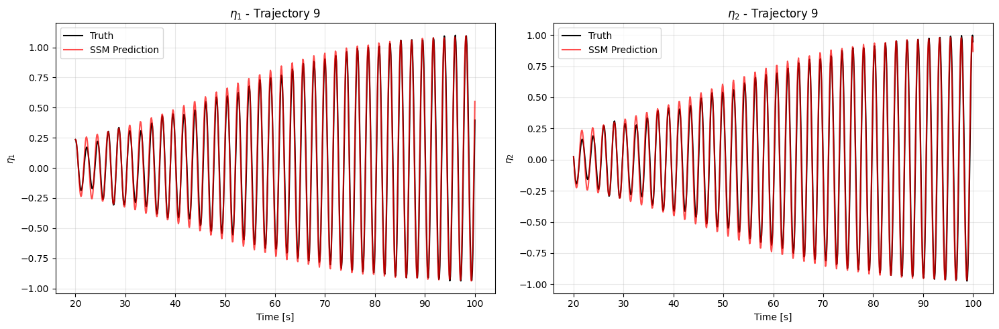

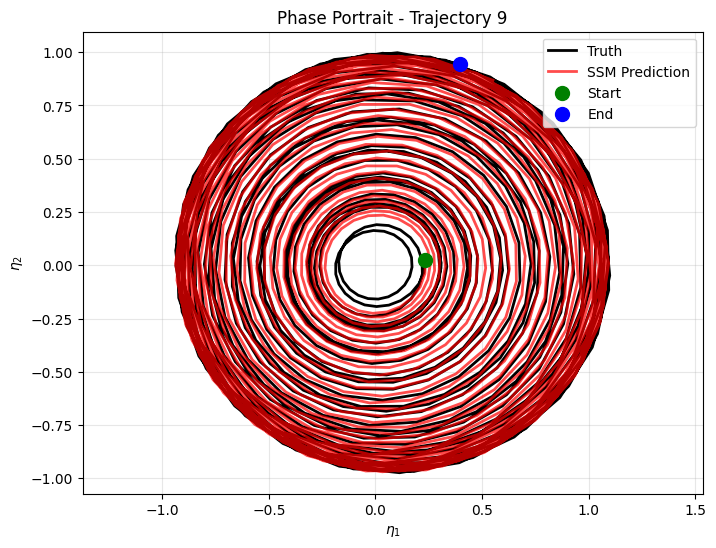


Prediction Error Statistics for Trajectory 9:
eta1 - Mean error: 0.062798, Max error: 0.170864
eta2 - Mean error: 0.060631, Max error: 0.161682
Total - Mean error: 0.096940, Max error: 0.173677

Frequency Analysis - Trajectory 9:
Dominant frequency in eta1: 0.4620 Hz
Dominant frequency in eta2: 0.4620 Hz
Period eta1: 2.1643 s
Period eta2: 2.1643 s



Angular frequency: 2.9031 rad/s
Comparison with reference (2.85): 1.86% difference


In [226]:
# Load trajectory number 9 (run9)
run_9_idx = 9
start_idx_9 = 200  # You can adjust this based on your preference

try:
    # Load run 9 data
    run_9_data = np.load(f"Re{Re}_low_res/run{run_9_idx}/U_field_alldata.npy").squeeze()
    trajectory_9 = (run_9_data - steady_state.reshape(-1,1))[:, start_idx_9:]
    time_9 = time[start_idx_9:]
    
    print(f"Successfully loaded run {run_9_idx}")
    print(f"Trajectory 9 shape: {trajectory_9.shape}")
    print(f"Time range: {time_9[0]:.2f} to {time_9[-1]:.2f} s")
    
    # Encode trajectory 9
    etas_9 = encode(trajectory_9)
    eta_init_9 = etas_9[:, 0]
    
    # Set up integration parameters
    t0_9 = time_9[0]
    t_final_9 = time_9[-1]
    
    print(f"Initial condition: eta1={eta_init_9[0]:.4f}, eta2={eta_init_9[1]:.4f}")
    
    # Solve the reduced dynamics for trajectory 9
    sol_9 = sc.integrate.solve_ivp(
        forced_rhs, 
        (t0_9, t_final_9), 
        eta_init_9, 
        t_eval=time_9, 
        method="DOP853"
    )
    
    print(f"Integration successful: {sol_9.success}")
    print(f"Integration message: {sol_9.message}")
    
    # Plot time series comparison
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    
    # eta1 time series
    axes[0].plot(time_9, etas_9[0,:], color="black", linewidth=1.5, label="Truth")
    axes[0].plot(sol_9.t, sol_9.y[0,:], color="red", linewidth=1.5, label="SSM Prediction", alpha=0.7)
    axes[0].legend()
    axes[0].set_ylabel("$\eta_1$")
    axes[0].set_xlabel("Time [s]")
    axes[0].set_title(f"$\eta_1$ - Trajectory 9")
    axes[0].grid(True, alpha=0.3)
    
    # eta2 time series
    axes[1].plot(time_9, etas_9[1,:], color="black", linewidth=1.5, label="Truth")
    axes[1].plot(sol_9.t, sol_9.y[1,:], color="red", linewidth=1.5, label="SSM Prediction", alpha=0.7)
    axes[1].legend()
    axes[1].set_ylabel("$\eta_2$")
    axes[1].set_xlabel("Time [s]")
    axes[1].set_title(f"$\eta_2$ - Trajectory 9")
    axes[1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Phase portrait
    plt.figure(figsize=(8, 6))
    start_idx = 0
    plt.plot(etas_9[0,start_idx:], etas_9[1,start_idx:], color="black", linewidth=2, label="Truth")
    plt.plot(sol_9.y[0,start_idx:], sol_9.y[1,start_idx:], color="red", linewidth=2, label="SSM Prediction", alpha=0.7)
    plt.scatter(etas_9[0,0], etas_9[1,0], color="green", s=100, label="Start", zorder=5)
    plt.scatter(etas_9[0,-1], etas_9[1,-1], color="blue", s=100, label="End", zorder=5)
    plt.legend()
    plt.xlabel("$\eta_1$")
    plt.ylabel("$\eta_2$")
    plt.title(f"Phase Portrait - Trajectory 9")
    plt.grid(True, alpha=0.3)
    plt.axis('equal')
    plt.show()
    
    # Calculate prediction errors
    eta1_error_9 = np.abs(etas_9[0,:] - sol_9.y[0,:])
    eta2_error_9 = np.abs(etas_9[1,:] - sol_9.y[1,:])
    total_error_9 = np.sqrt(eta1_error_9**2 + eta2_error_9**2)
    
    print(f"\nPrediction Error Statistics for Trajectory 9:")
    print(f"eta1 - Mean error: {np.mean(eta1_error_9):.6f}, Max error: {np.max(eta1_error_9):.6f}")
    print(f"eta2 - Mean error: {np.mean(eta2_error_9):.6f}, Max error: {np.max(eta2_error_9):.6f}")
    print(f"Total - Mean error: {np.mean(total_error_9):.6f}, Max error: {np.max(total_error_9):.6f}")
    
    # FFT analysis of trajectory 9
    eta1_signal_9 = etas_9[0, :]
    eta2_signal_9 = etas_9[1, :]
    
    # Calculate sampling parameters
    dt_9 = time_9[1] - time_9[0]
    fs_9 = 1 / dt_9
    N_9 = len(eta1_signal_9)
    
    # Perform FFT
    fft_eta1_9 = fft(eta1_signal_9)
    fft_eta2_9 = fft(eta2_signal_9)
    
    # Get frequency array
    freqs_9 = fftfreq(N_9, dt_9)
    positive_freqs_9 = freqs_9[:N_9//2]
    fft_eta1_positive_9 = np.abs(fft_eta1_9[:N_9//2])
    fft_eta2_positive_9 = np.abs(fft_eta2_9[:N_9//2])
    
    # Find dominant frequencies
    dominant_freq_idx_eta1_9 = np.argmax(fft_eta1_positive_9[1:]) + 1
    dominant_freq_idx_eta2_9 = np.argmax(fft_eta2_positive_9[1:]) + 1
    
    dominant_freq_eta1_9 = positive_freqs_9[dominant_freq_idx_eta1_9]
    dominant_freq_eta2_9 = positive_freqs_9[dominant_freq_idx_eta2_9]
    
    print(f"\nFrequency Analysis - Trajectory 9:")
    print(f"Dominant frequency in eta1: {dominant_freq_eta1_9:.4f} Hz")
    print(f"Dominant frequency in eta2: {dominant_freq_eta2_9:.4f} Hz")
    print(f"Period eta1: {1/dominant_freq_eta1_9:.4f} s")
    print(f"Period eta2: {1/dominant_freq_eta2_9:.4f} s")
    
    # 3D plot with shift mode for trajectory 9
    shift_coeff_trajectory_9 = calculate_shift_coefficient(trajectory_9, shift_mode)
    ssm_prediction_9 = ssm.decode(sol_9.y)
    shift_coeff_predicted_9 = calculate_shift_coefficient(ssm_prediction_9, shift_mode)
    
    # Create 3D plotly figure
    surface = go.Surface(
        x=X, y=Y, z=shift_coeff_surface,
        colorscale='Blues',
        opacity=0.7,
        showscale=False,
    )
    
    trajectory_9_3d = go.Scatter3d(
        x=etas_9[0, :],
        y=etas_9[1, :],
        z=shift_coeff_trajectory_9,
        mode='lines',
        line=dict(color='black', width=4),
        name='True Trajectory 9',
    )
    
    trajectory_predicted_9_3d = go.Scatter3d(
        x=sol_9.y[0, :],
        y=sol_9.y[1, :],
        z=shift_coeff_predicted_9,
        mode='lines',
        line=dict(color='red', width=4),
        name='SSM Prediction 9',
    )
    
    # Start and end points
    start_point_9 = go.Scatter3d(
        x=[etas_9[0, 0]],
        y=[etas_9[1, 0]],
        z=[shift_coeff_trajectory_9[0]],
        mode='markers',
        marker=dict(color='green', size=8),
        name='Start',
    )
    
    end_point_9 = go.Scatter3d(
        x=[etas_9[0, -1]],
        y=[etas_9[1, -1]],
        z=[shift_coeff_trajectory_9[-1]],
        mode='markers',
        marker=dict(color='blue', size=8),
        name='End',
    )
    
    fig_3d_9 = go.Figure(data=[surface, trajectory_9_3d, trajectory_predicted_9_3d, start_point_9, end_point_9])
    fig_3d_9.update_layout(
        scene=dict(
            xaxis_title=r'$\eta_1$',
            yaxis_title=r'$\eta_2$',
            zaxis_title='Shift Mode Coefficient',
        ),
        title='SSM Manifold with Shift Mode - Trajectory 9',
        width=800,
        height=800,
    )
    
    fig_3d_9.show()
    
    # Compare frequency with angular frequency
    angular_freq_9 = 2 * np.pi * dominant_freq_eta1_9
    print(f"\nAngular frequency: {angular_freq_9:.4f} rad/s")
    print(f"Comparison with reference (2.85): {(angular_freq_9 - 2.85)/2.85 * 100:.2f}% difference")

except FileNotFoundError:
    print(f"❌ Run {run_9_idx} not found!")
    print("Available files:")
    import os
    data_dir = f"Re{Re}_low_res/"
    if os.path.exists(data_dir):
        available_runs = [d for d in os.listdir(data_dir) if d.startswith('run')]
        print(f"Available runs: {sorted(available_runs)}")
    else:
        print(f"Directory {data_dir} does not exist")

except Exception as e:
    print(f"❌ Error loading trajectory 9: {e}")